In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV
from imblearn.over_sampling import RandomOverSampler, ADASYN, SMOTE
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import VarianceThreshold
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
import pickle

import warnings
warnings.filterwarnings(action = 'ignore')

In [2]:
df = pd.read_csv('../Data/Crop_recommendation.csv')

In [3]:
df.head()

,N,P,K,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice


In [4]:
df.tail()

,N,P,K,temperature,humidity,ph,rainfall,label
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee
2199,104,18,30,23.603016,60.396475,6.779833,140.937041,coffee


In [5]:
df.shape

(2200, 8)

This dataset contain 2200 rows and 8 columns.

In [6]:
all_col = list(df.columns)

print("All features : ", all_col)

All features :  ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label']


In [7]:
df.duplicated().sum()

0

This dataset doesn't contain any duplicate value.

In [8]:
df.isnull().sum()

N              0
P              0
K              0
temperature    0
humidity       0
ph             0
rainfall       0
label          0
dtype: int64

This dataset doesn't contain any null value.

In [9]:
 df.describe().T

,count,mean,std,min,25%,50%,75%,max
N,2200.0,50.551818,36.917334,0.000000,21.000000,37.000000,84.250000,140.000000
P,2200.0,53.362727,32.985883,5.000000,28.000000,51.000000,68.000000,145.000000
K,2200.0,48.149091,50.647931,5.000000,20.000000,32.000000,49.000000,205.000000
temperature,2200.0,25.616244,5.063749,8.825675,22.769375,25.598693,28.561654,43.675493
humidity,2200.0,71.481779,22.263812,14.258040,60.261953,80.473146,89.948771,99.981876
ph,2200.0,6.469480,0.773938,3.504752,5.971693,6.425045,6.923643,9.935091
rainfall,2200.0,103.463655,54.958389,20.211267,64.551686,94.867624,124.267508,298.560117


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2200 entries, 0 to 2199
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   N            2200 non-null   int64  
 1   P            2200 non-null   int64  
 2   K            2200 non-null   int64  
 3   temperature  2200 non-null   float64
 4   humidity     2200 non-null   float64
 5   ph           2200 non-null   float64
 6   rainfall     2200 non-null   float64
 7   label        2200 non-null   object 
dtypes: float64(4), int64(3), object(1)
memory usage: 137.6+ KB


In [11]:
num_col = list(df._get_numeric_data())
cat_col = list(set(all_col) - set(num_col))

print(f"All features : {all_col}")
print(f"\nNumerical features : {num_col}")
print(f"\nCategorical features : {cat_col}")

All features : ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label']

Numerical features : ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']

Categorical features : ['label']


In [12]:
df.nunique()

N               137
P               117
K                73
temperature    2200
humidity       2200
ph             2200
rainfall       2200
label            22
dtype: int64

In [13]:
df['label'].value_counts()

rice           100
maize          100
jute           100
cotton         100
coconut        100
papaya         100
orange         100
apple          100
muskmelon      100
watermelon     100
grapes         100
mango          100
banana         100
pomegranate    100
lentil         100
blackgram      100
mungbean       100
mothbeans      100
pigeonpeas     100
kidneybeans    100
chickpea       100
coffee         100
Name: label, dtype: int64

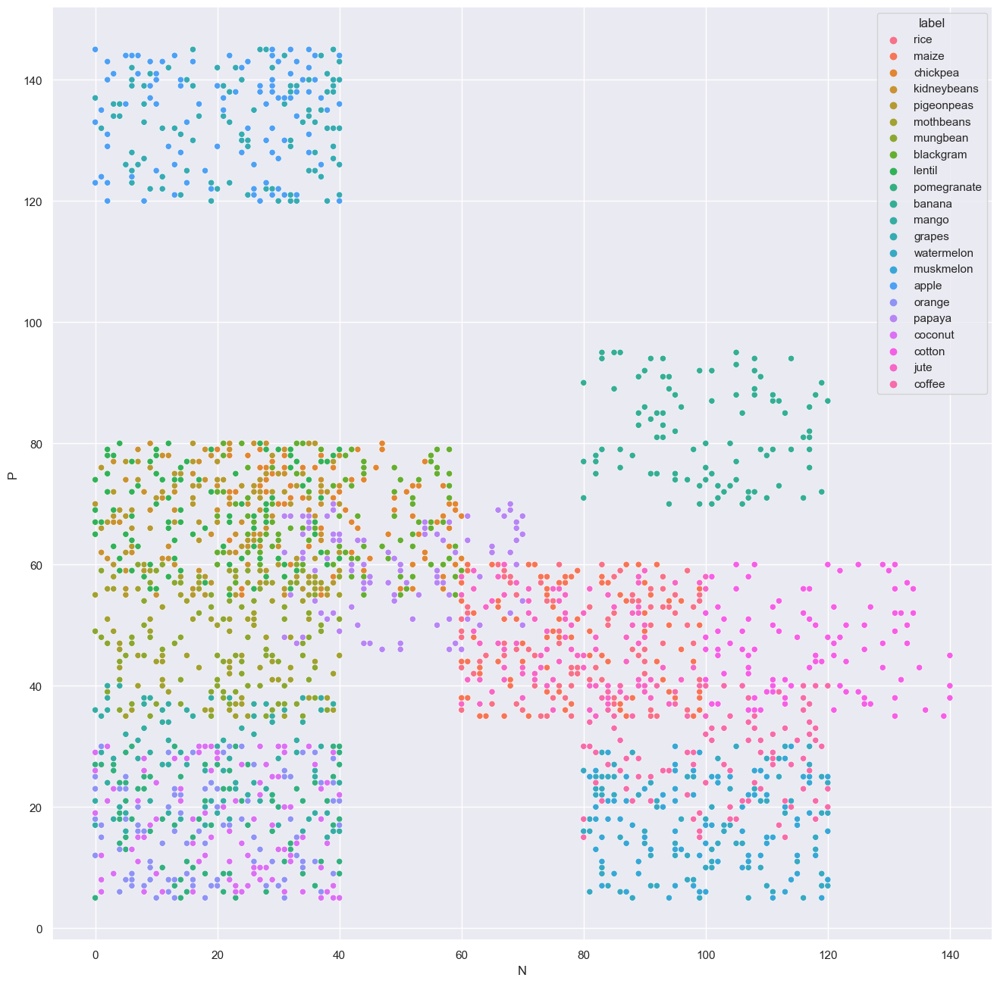

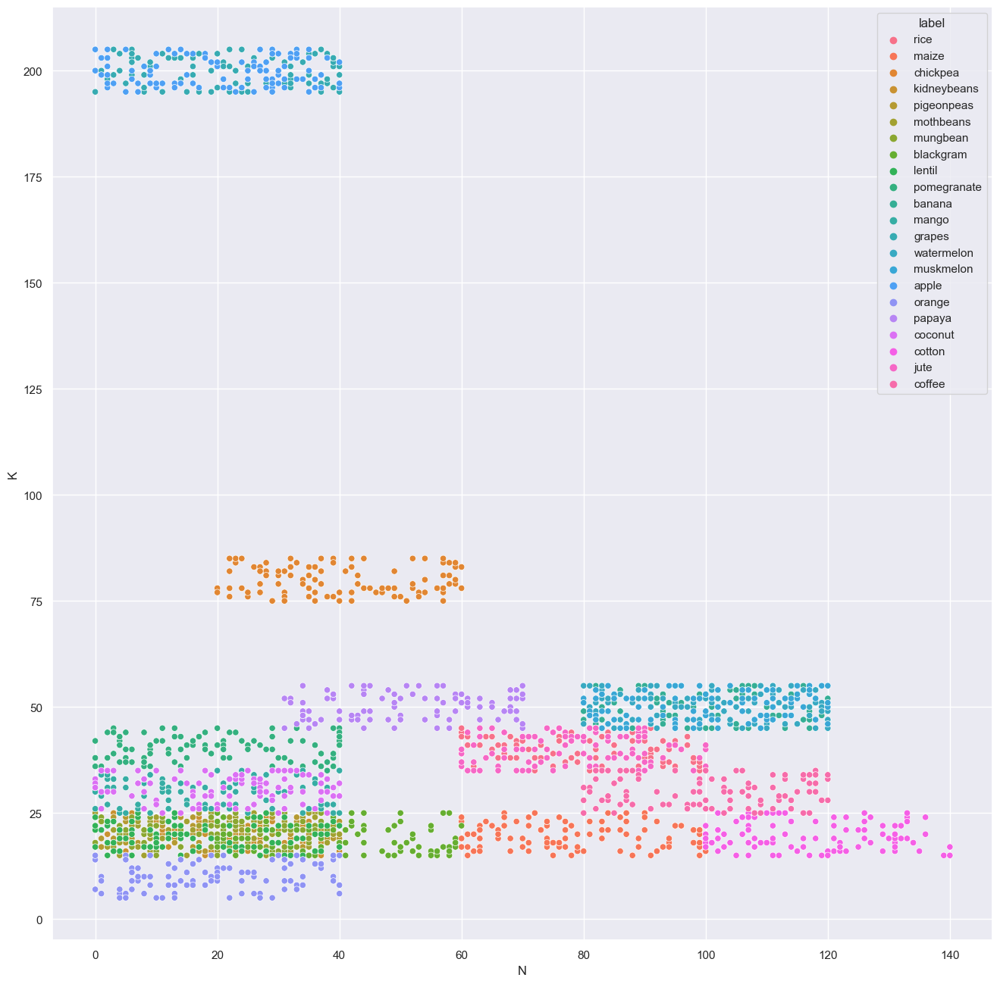

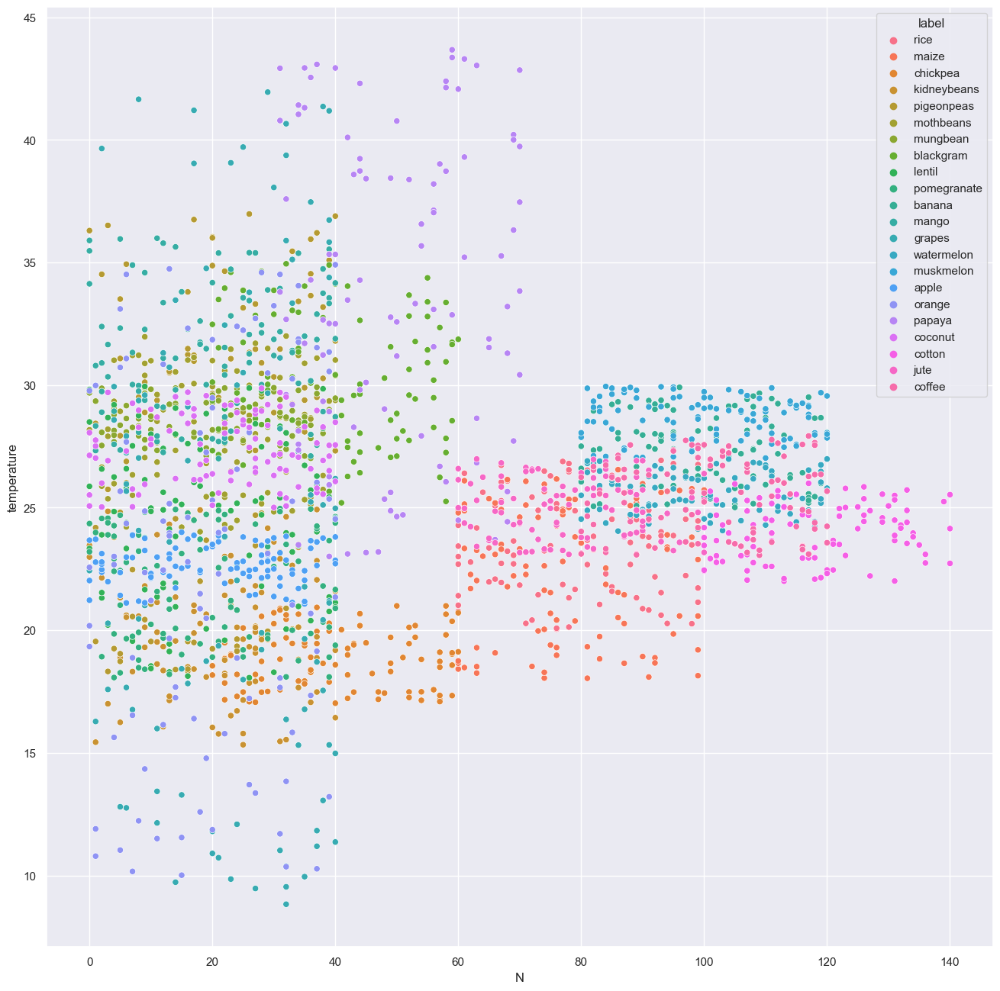

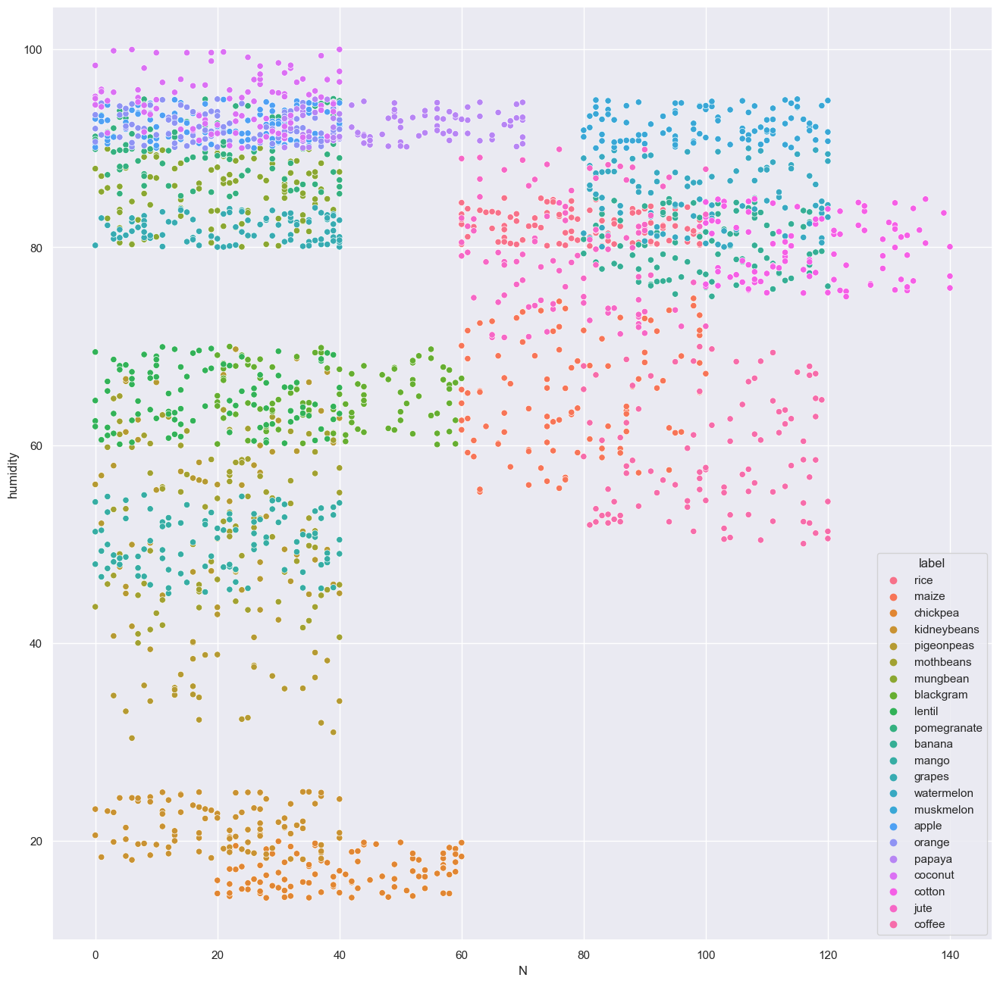

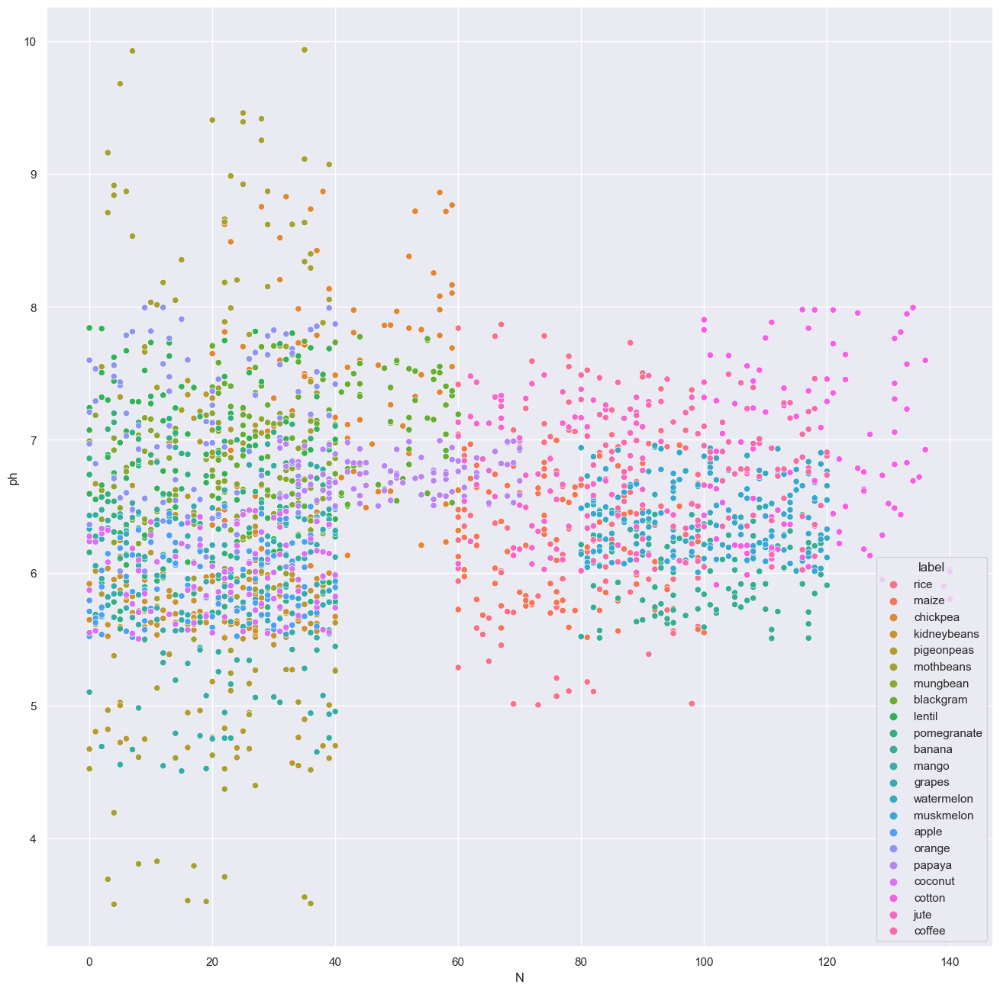

...

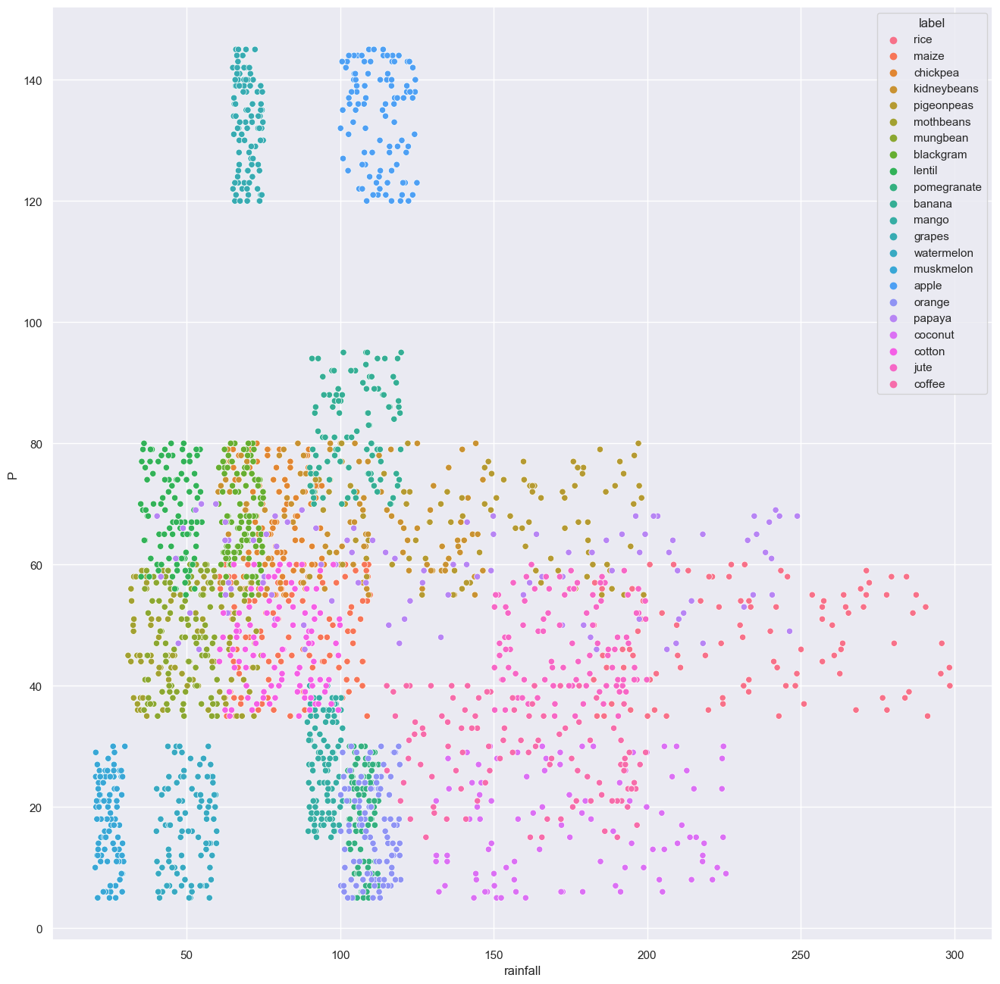

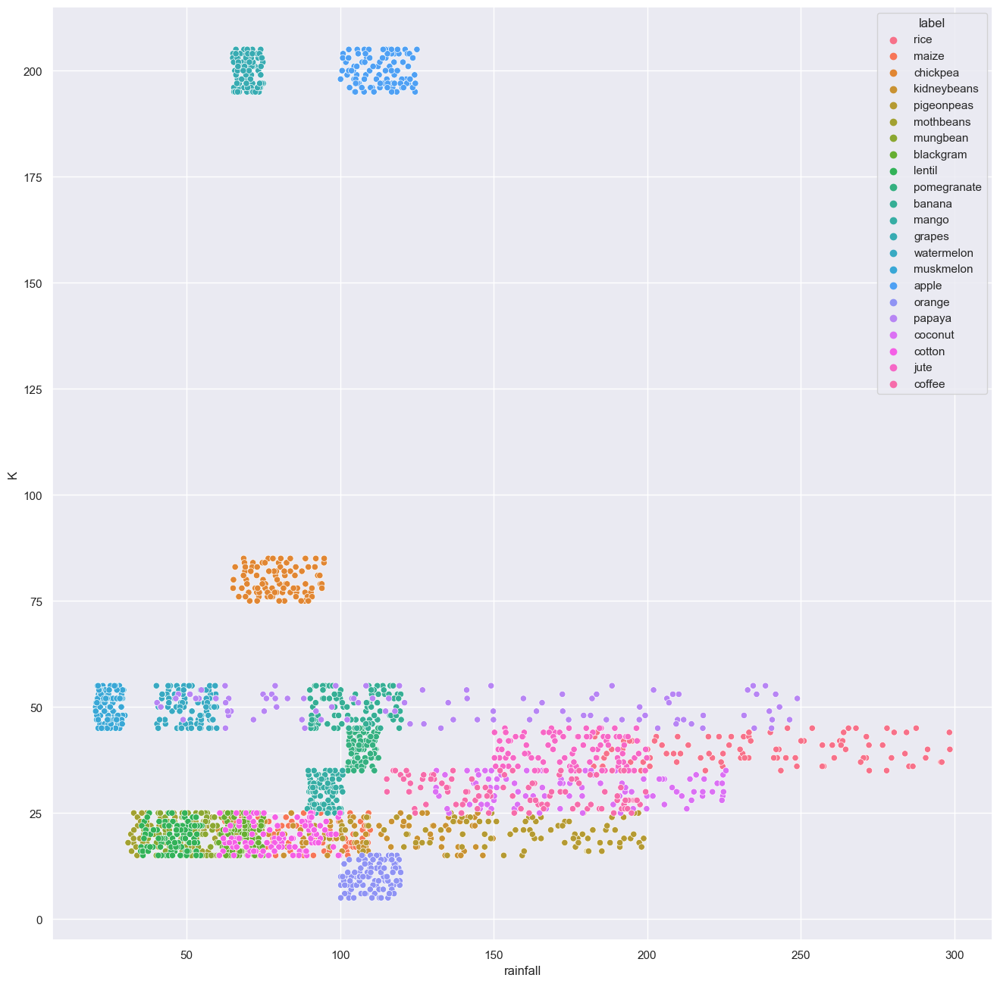

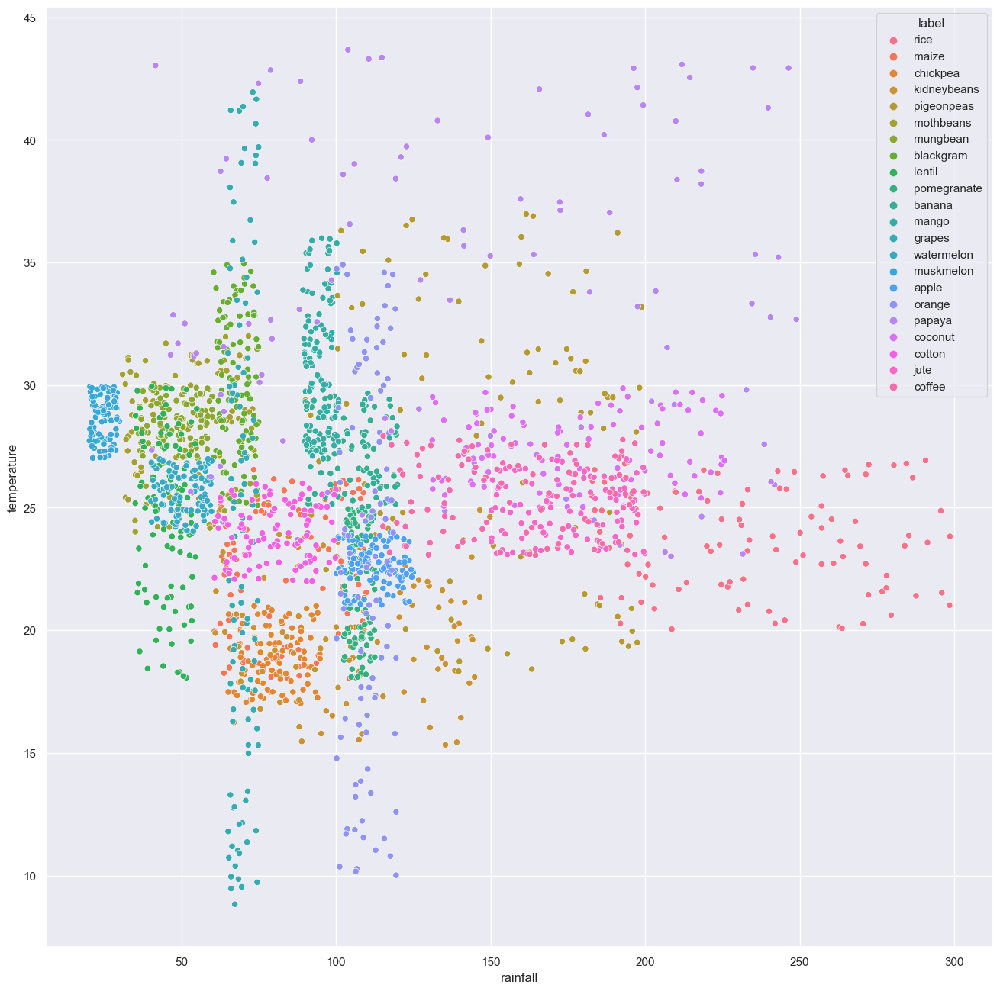

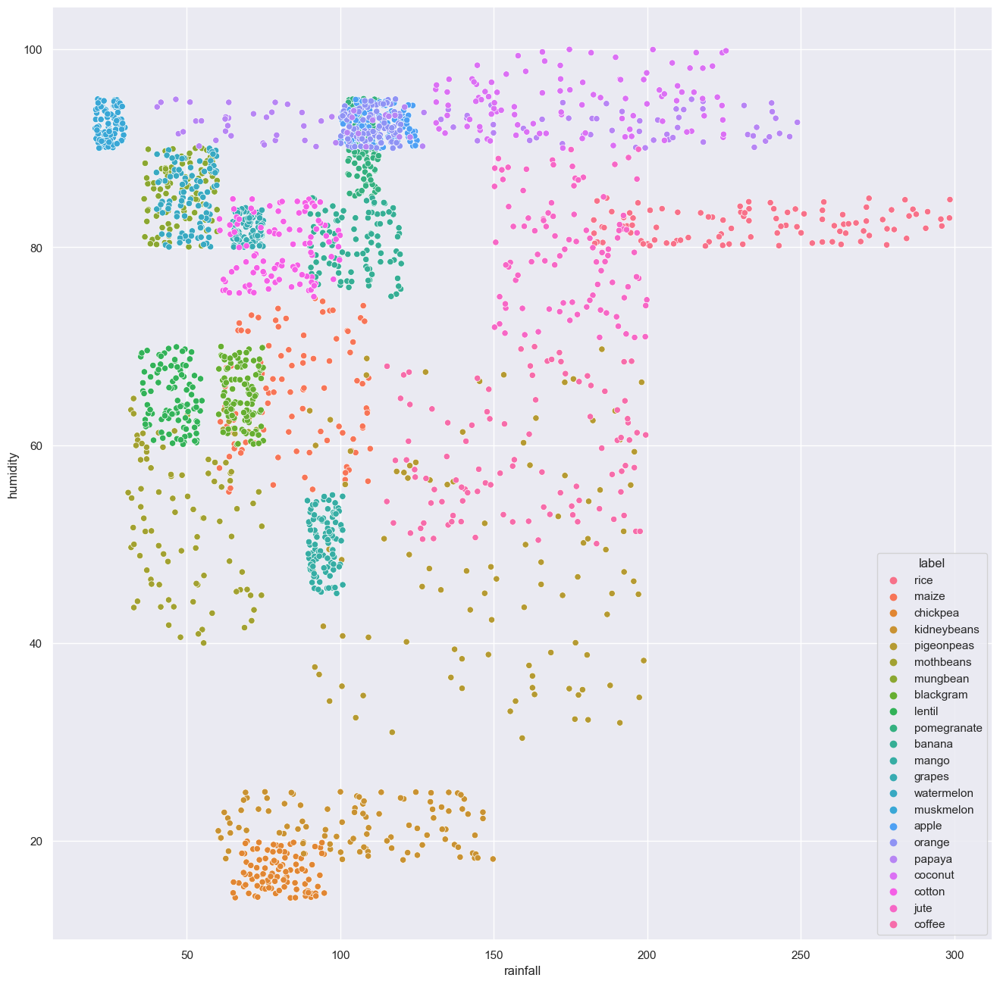

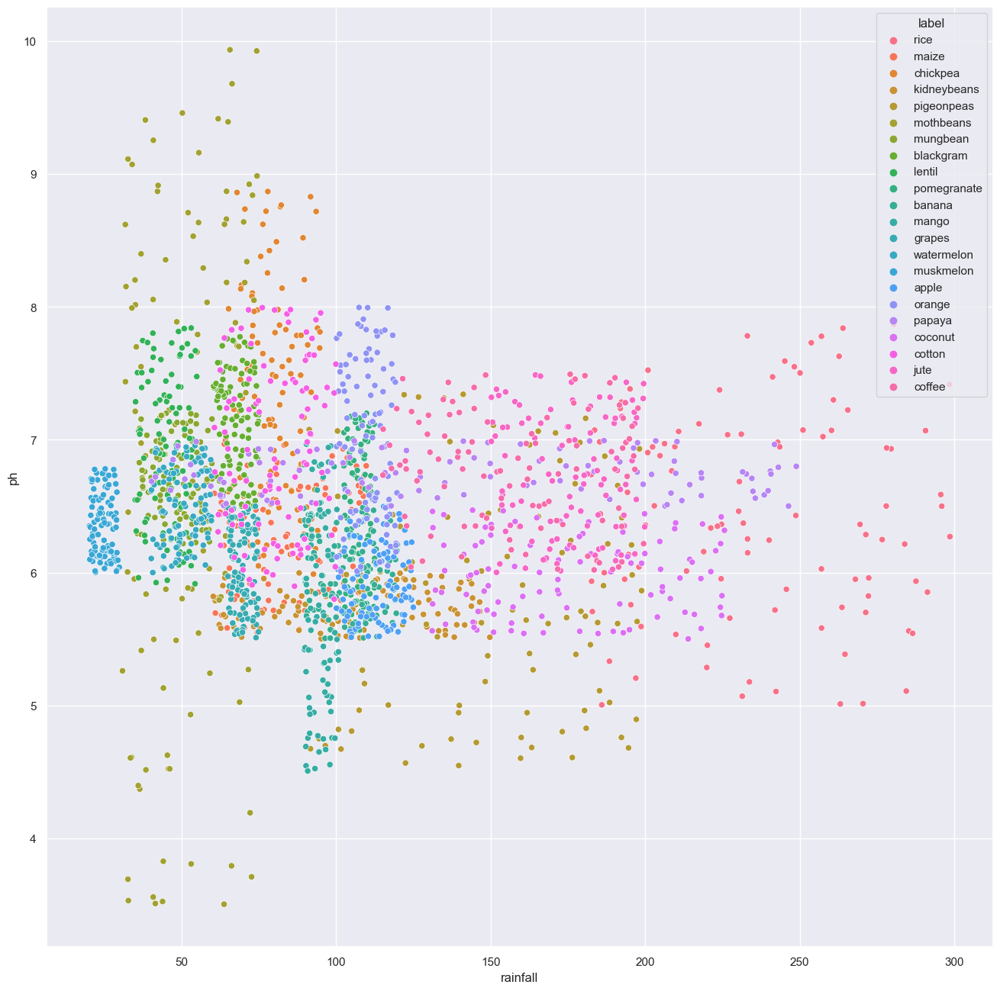

In [14]:
for i in num_col:
    for j in num_col:
        if i == j:
            continue
        sns.set()
        plt.figure(figsize = (16, 16))
        sns.scatterplot(x = i, y = j, data = df, hue = 'label')
        plt.xlabel(i)
        plt.ylabel(j)
        plt.show()

<Figure size 5000x5000 with 0 Axes>

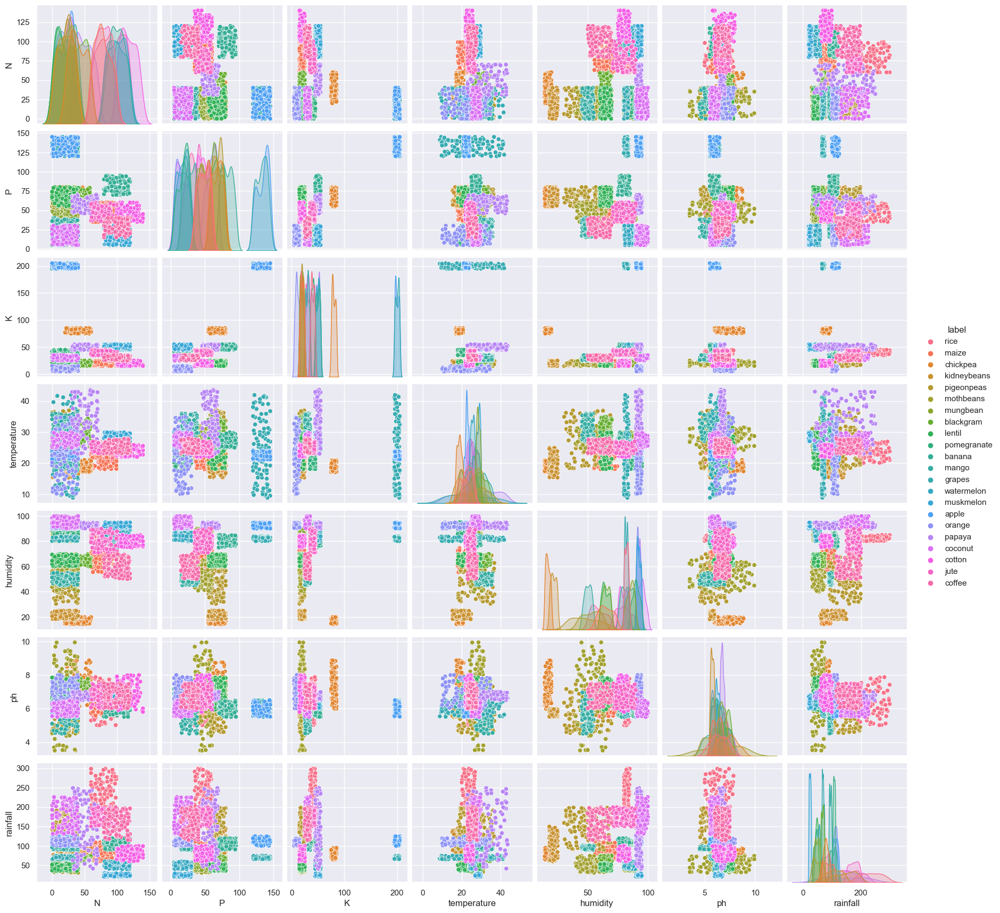

In [15]:
sns.set()
plt.figure(figsize = (50, 50))
sns.pairplot(data = df, hue = 'label')
plt.show()

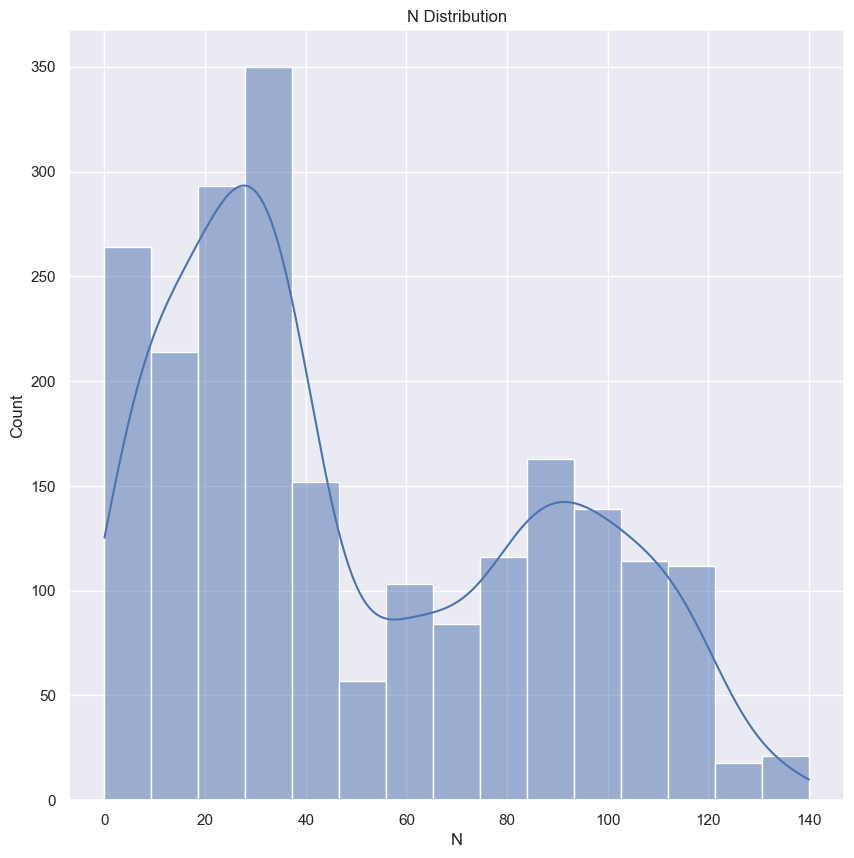

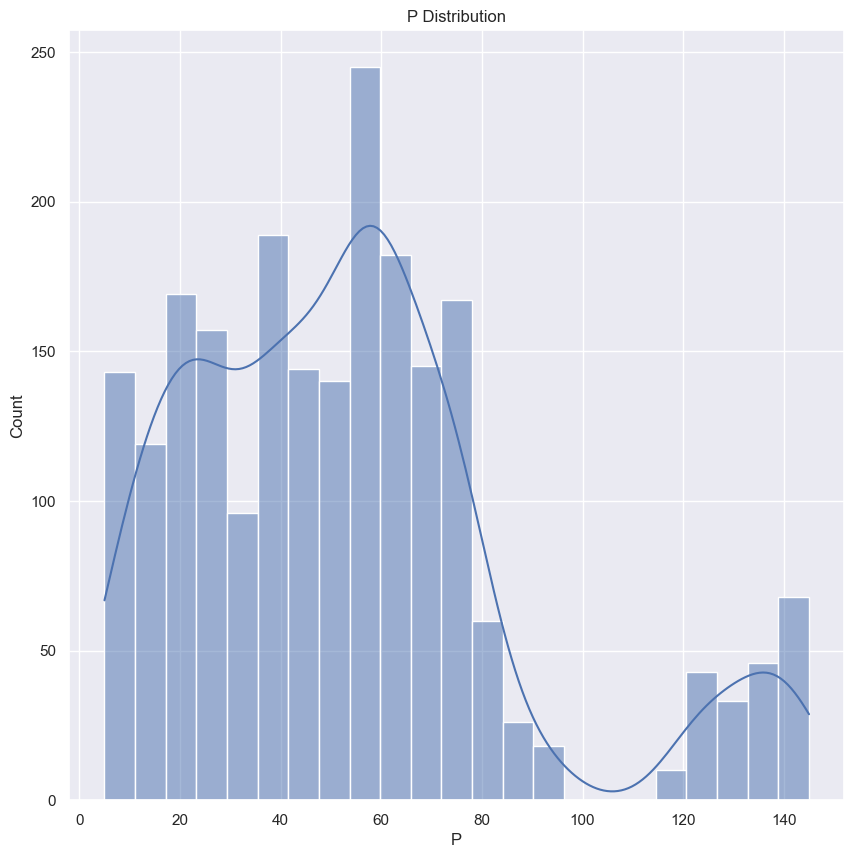

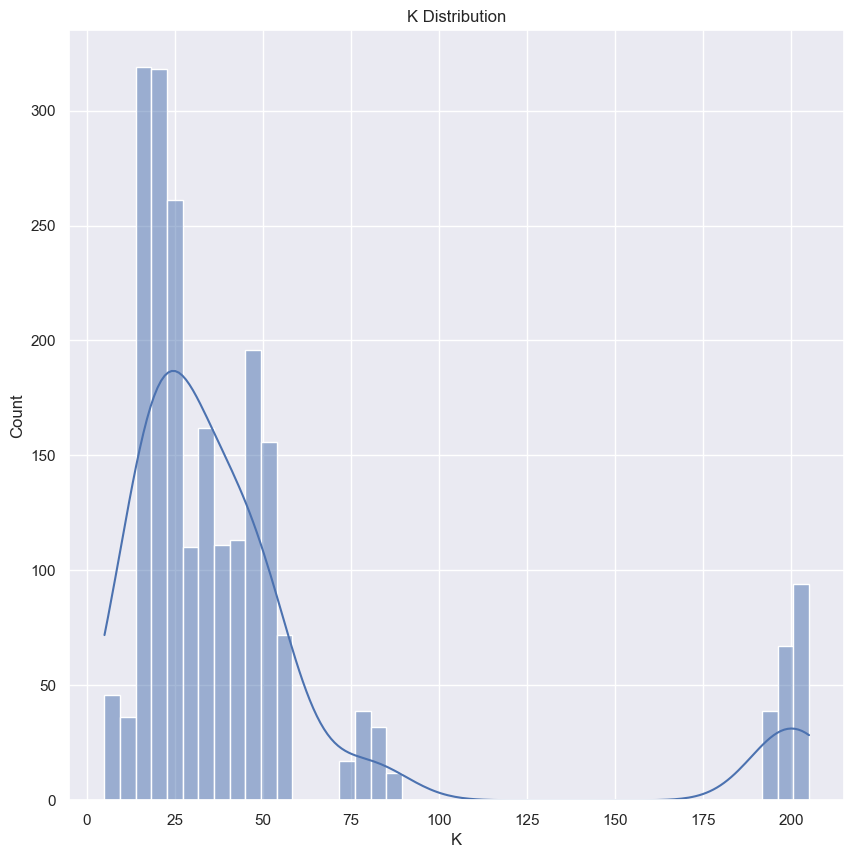

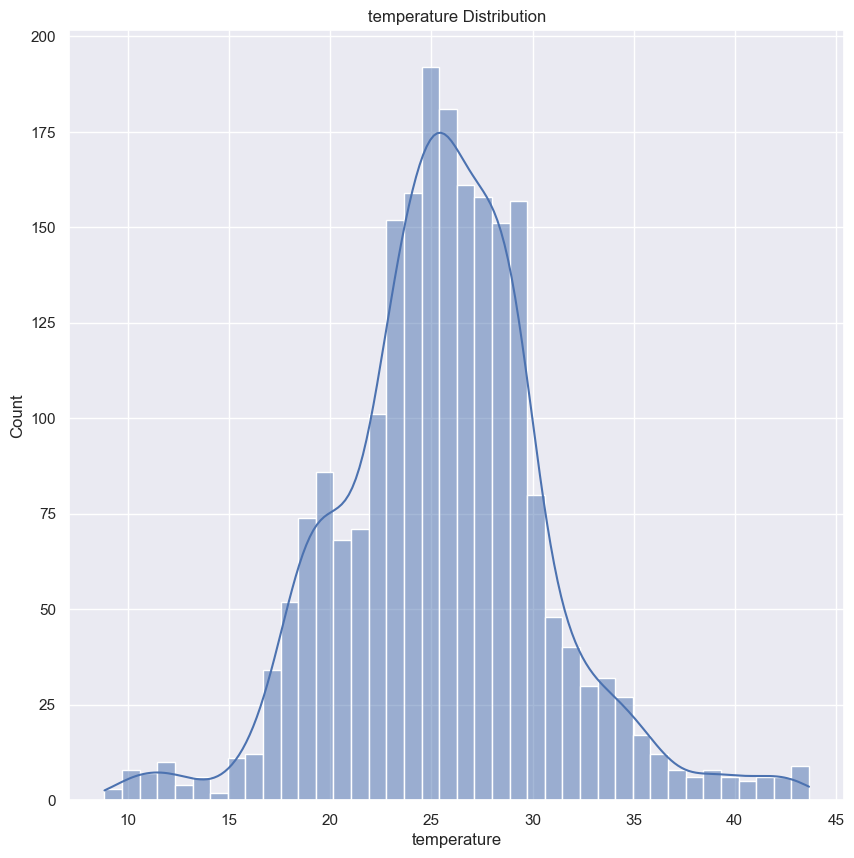

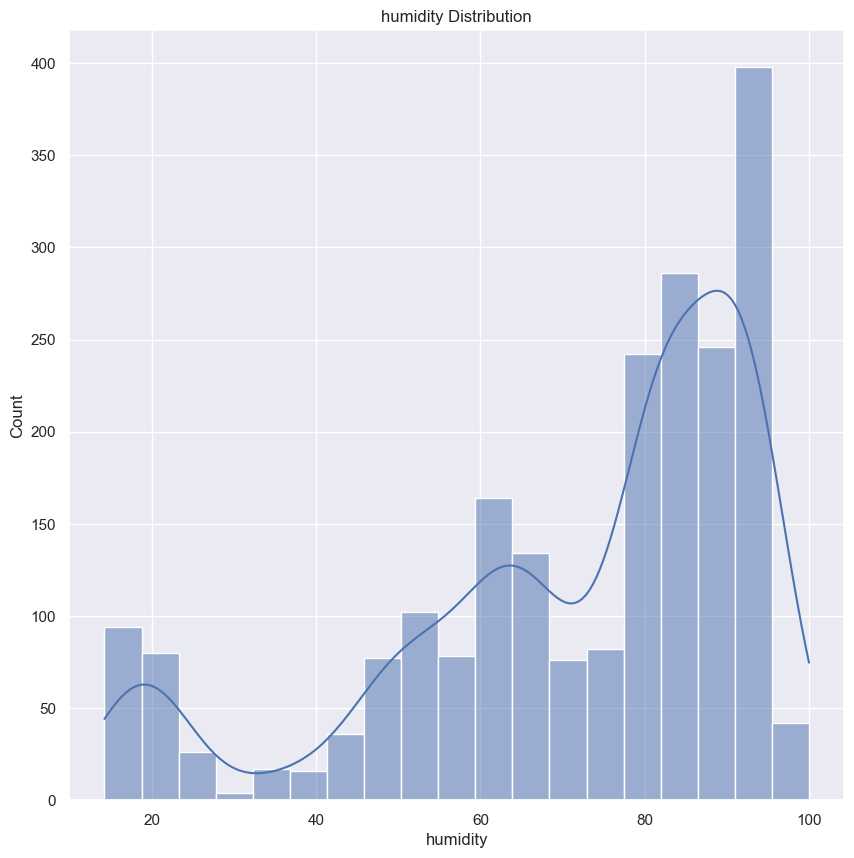

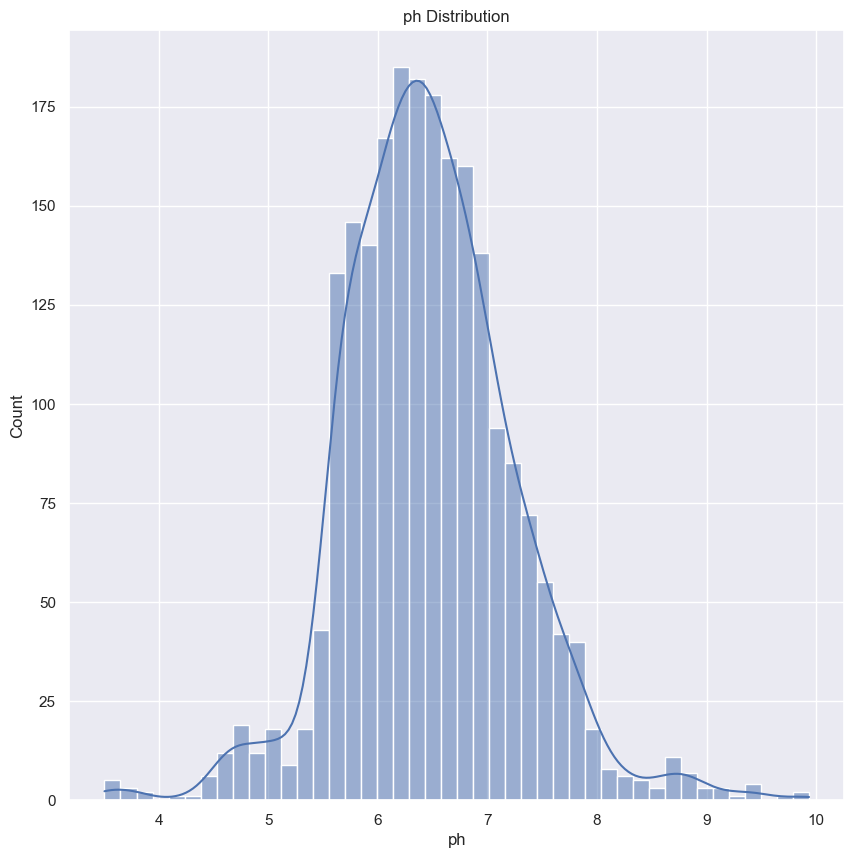

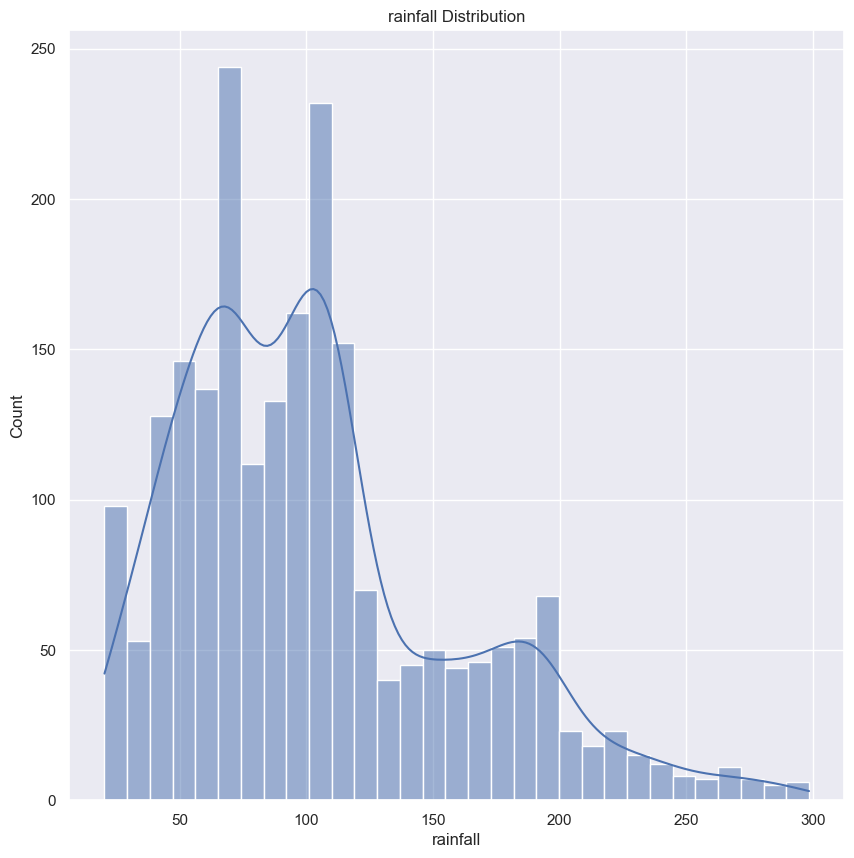

In [27]:
for i in num_col:
    sns.set()
    plt.figure(figsize = (10, 10))
    sns.histplot(data = df, x = i, kde = True)
    plt.title(f"{i} Distribution")
    plt.show()

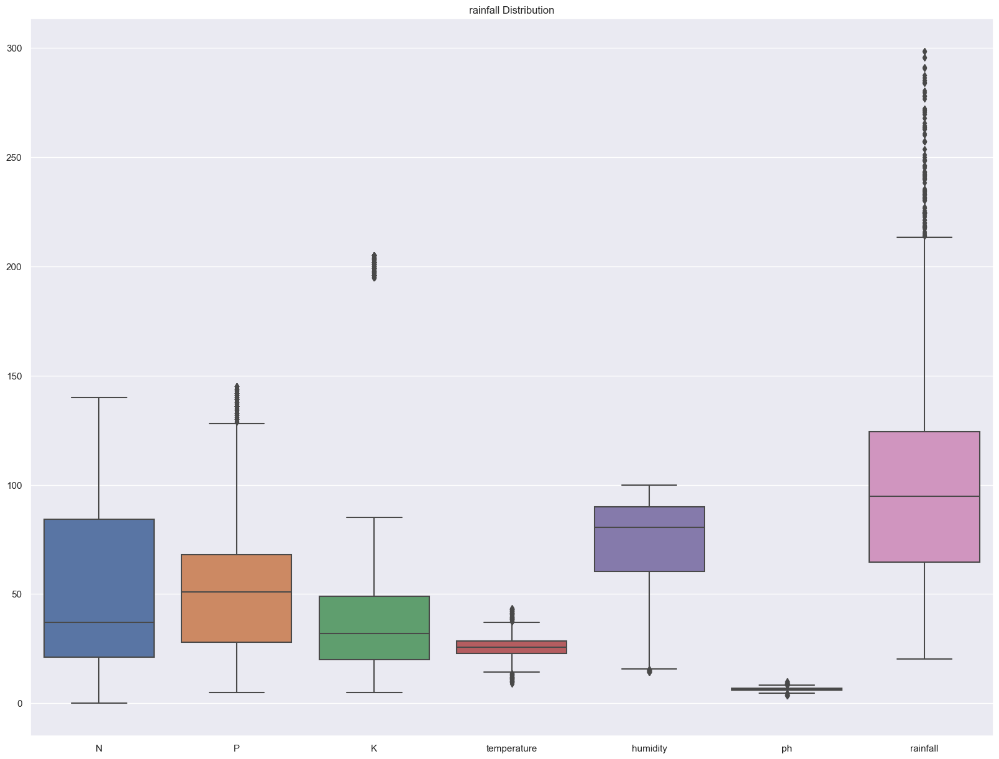

In [30]:
sns.set()
plt.figure(figsize = (20, 15))
sns.boxplot(data = df)
plt.title(f"{i} Distribution")
plt.show()

In [14]:
for i in num_col:
    q1 = df[i].quantile(0.25)
    q3 = df[i].quantile(0.75)
    IQR = q3 - q1
    upper = q3 + (1.5 * IQR)
    lower = q1 - (1.5 * IQR)
    df.loc[(df[i] > upper), i] = upper
    df.loc[(df[i] < lower), i] = lower

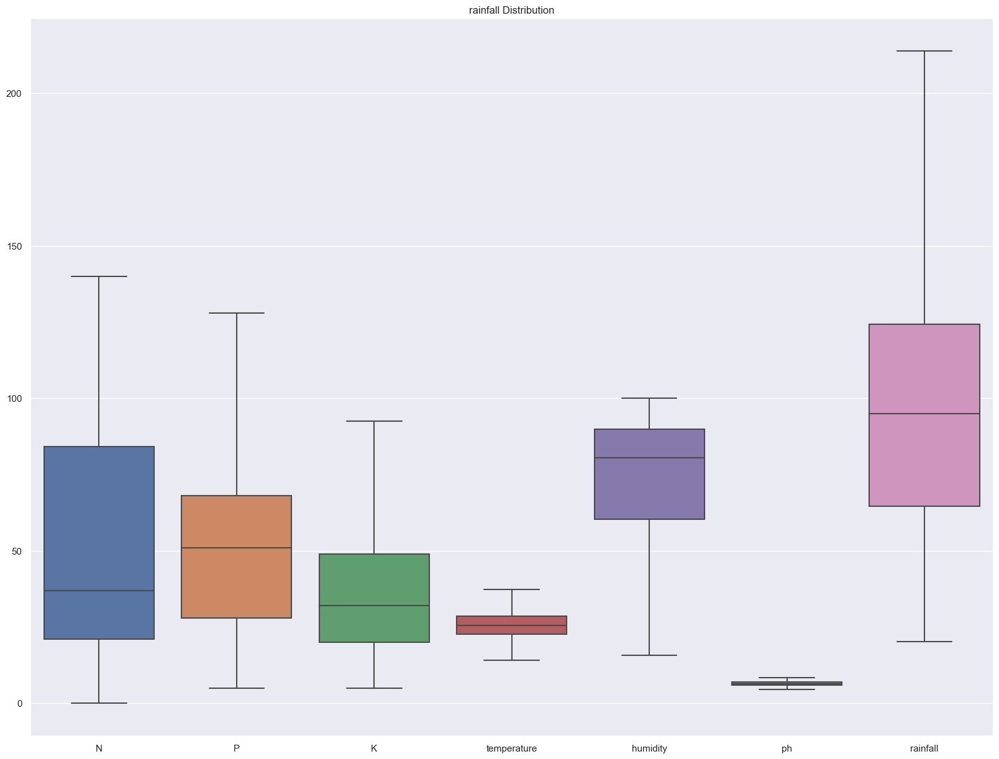

In [16]:
sns.set()
plt.figure(figsize = (20, 15))
sns.boxplot(data = df)
plt.title(f"{i} Distribution")
plt.show()

rice           4.545455
maize          4.545455
jute           4.545455
cotton         4.545455
coconut        4.545455
papaya         4.545455
orange         4.545455
apple          4.545455
muskmelon      4.545455
watermelon     4.545455
grapes         4.545455
mango          4.545455
banana         4.545455
pomegranate    4.545455
lentil         4.545455
blackgram      4.545455
mungbean       4.545455
mothbeans      4.545455
pigeonpeas     4.545455
kidneybeans    4.545455
chickpea       4.545455
coffee         4.545455
Name: label, dtype: float64


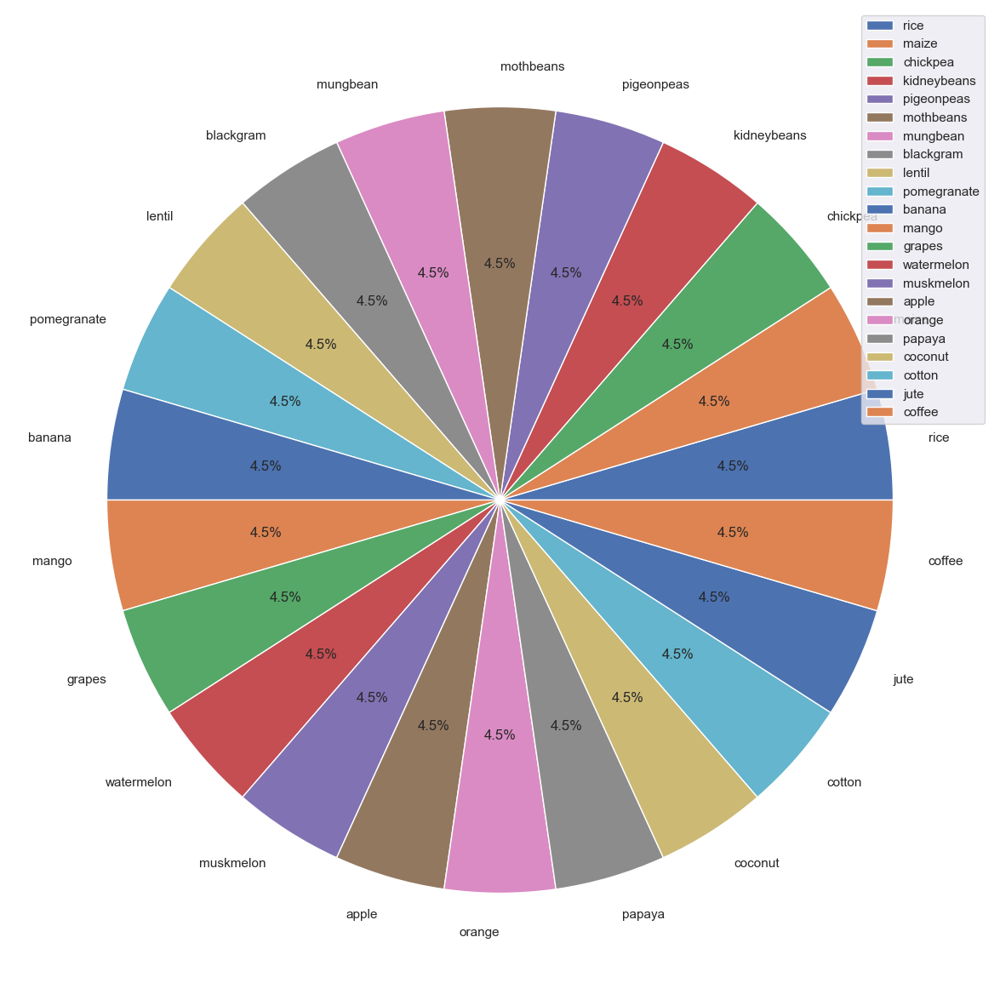

In [17]:
x = df['label'].value_counts(normalize = True)
print(x * 100)
labels = df['label'].unique()

sns.set()
plt.figure(figsize =(15, 15))
plt.pie(x = x, labels = labels, autopct = "%1.1f%%")
plt.legend()
plt.show()

# Split data.

In [15]:
x = df.drop(columns = ['label'], axis = 1)
y = df[['label']]

In [16]:
x.head()

,N,P,K,temperature,humidity,ph,rainfall
0,90.0,42,43.0,20.879744,82.002744,6.502985,202.935536
1,85.0,58,41.0,21.770462,80.319644,7.038096,213.841241
2,60.0,55,44.0,23.004459,82.320763,7.840207,213.841241
3,74.0,35,40.0,26.491096,80.158363,6.980401,213.841241
4,78.0,42,42.0,20.130175,81.604873,7.628473,213.841241


In [17]:
print(f"x has : {x.shape}")

x has : (2200, 7)


x has 2200 rows and 7 columns.

In [18]:
y.head()

,label
0,rice
1,rice
2,rice
3,rice
4,rice


In [19]:
print(f"y has : {y.shape}")

y has : (2200, 1)


y has 2200 rows and 1 column.

In [20]:
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state = 54, train_size = 0.85)

In [21]:
print("x_train has : ", x_train.shape)
print("y_train has : ", y_train.shape)
print("x_test has : ", x_test.shape)
print("y_test has :", y_test.shape)

x_train has :  (1870, 7)
y_train has :  (1870, 1)
x_test has :  (330, 7)
y_test has : (330, 1)


# Correlation of the dataset.

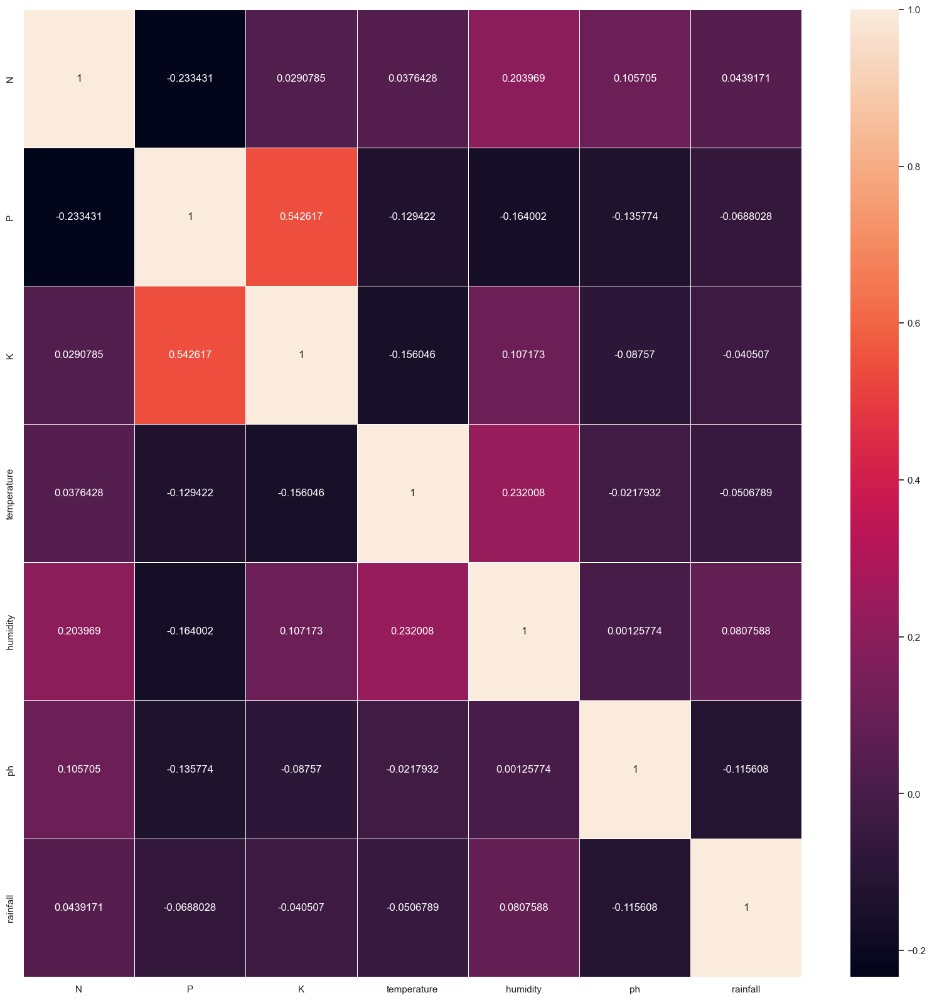

In [22]:
sns.set()
plt.figure(figsize = (20, 20))
sns.heatmap(x_train.corr(), annot = True, cmap = 'rocket', fmt = 'g', linewidths = 0.6)
plt.show()

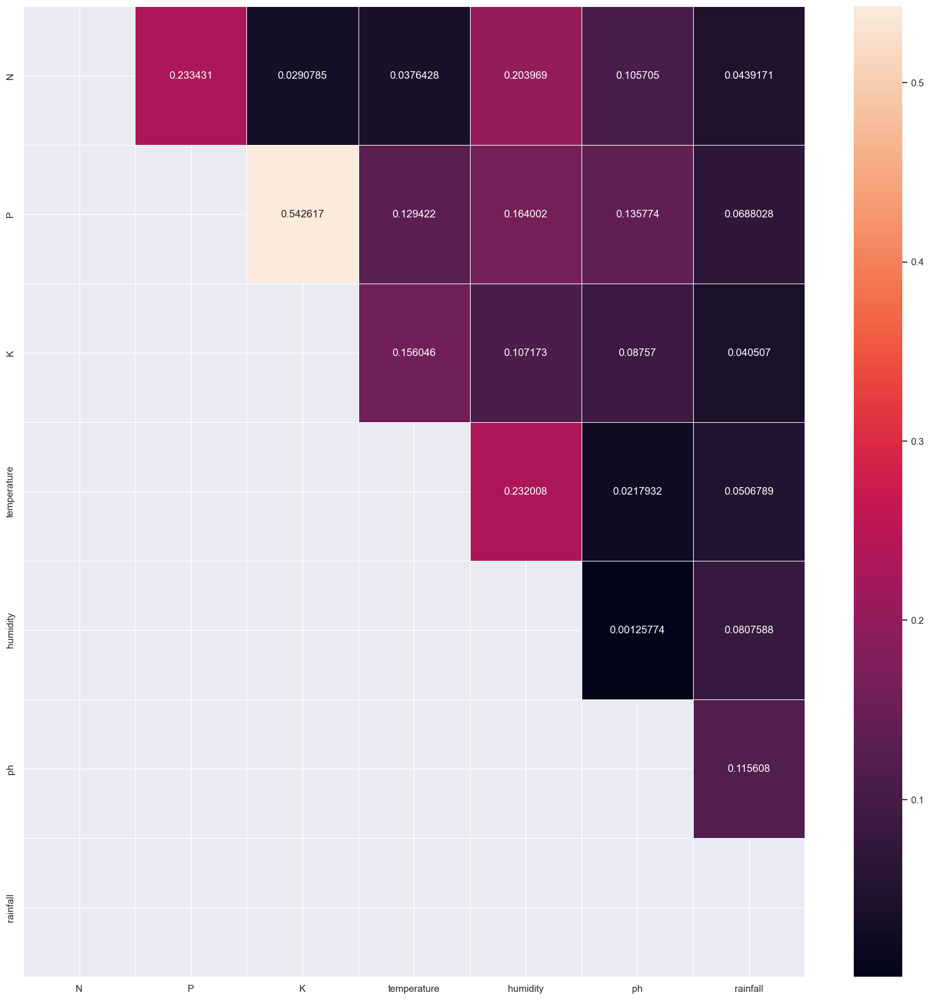

In [23]:
corr = x_train.corr().abs()

upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(np.bool))

sns.set()
plt.figure(figsize = (20, 20))
sns.heatmap(upper, annot = True, linewidths = 0.6, fmt = 'g', cmap = 'rocket')
plt.show()

In [24]:
to_drop = list(column for column in upper.columns if any(upper[column] > 0.95))

to_drop

[]

# Preprocessing pipeline

In [25]:
pre_pipe = Pipeline(steps = [
    ("StandardScalar", StandardScaler()),
    ("VarianceThreshold", VarianceThreshold(threshold = 0.0)), 
    ("PCA", PCA(0.95))
])

pre_pipe

Pipeline(steps=[('StandardScalar', StandardScaler()),
                ('VarianceThreshold', VarianceThreshold()),
                ('PCA', PCA(n_components=0.95))])

# Model building

In [26]:
def model_evaluating(y_true, y_pred):
    print(classification_report(y_true, y_pred))
    
    sns.set()
    plt.figure(figsize = (12, 12))
    sns.heatmap(data = confusion_matrix(y_true, y_pred), annot = True, fmt = 'g')
    plt.show()

In [27]:
def model_building(x_train, y_train, x_test, y_test, model):
    
    model.fit(x_train, y_train)
    
    y_pred = model.predict(x_test)
    
    model_evaluating(y_test,  y_pred)
    
    print('\n')
    print("Accuract score : ", accuracy_score(y_test, y_pred))

## Logistic Regression

In [28]:
lgr = Pipeline(steps = [
    ("preprocessor", pre_pipe),
    ("LogisticRegression", LogisticRegression())
])

lgr

Pipeline(steps=[('preprocessor',
                 Pipeline(steps=[('StandardScalar', StandardScaler()),
                                 ('VarianceThreshold', VarianceThreshold()),
                                 ('PCA', PCA(n_components=0.95))])),
                ('LogisticRegression', LogisticRegression())])

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        30
      banana       1.00      1.00      1.00        15
   blackgram       1.00      1.00      1.00        14
    chickpea       1.00      1.00      1.00        11
     coconut       1.00      1.00      1.00        16
      coffee       1.00      1.00      1.00        13
      cotton       1.00      1.00      1.00        16
      grapes       1.00      1.00      1.00         9
        jute       0.85      1.00      0.92        11
 kidneybeans       0.86      1.00      0.92         6
      lentil       1.00      0.94      0.97        16
       maize       1.00      1.00      1.00        21
       mango       1.00      1.00      1.00        18
   mothbeans       0.94      1.00      0.97        16
    mungbean       1.00      1.00      1.00        15
   muskmelon       1.00      1.00      1.00        11
      orange       1.00      1.00      1.00        17
      papaya       1.00    

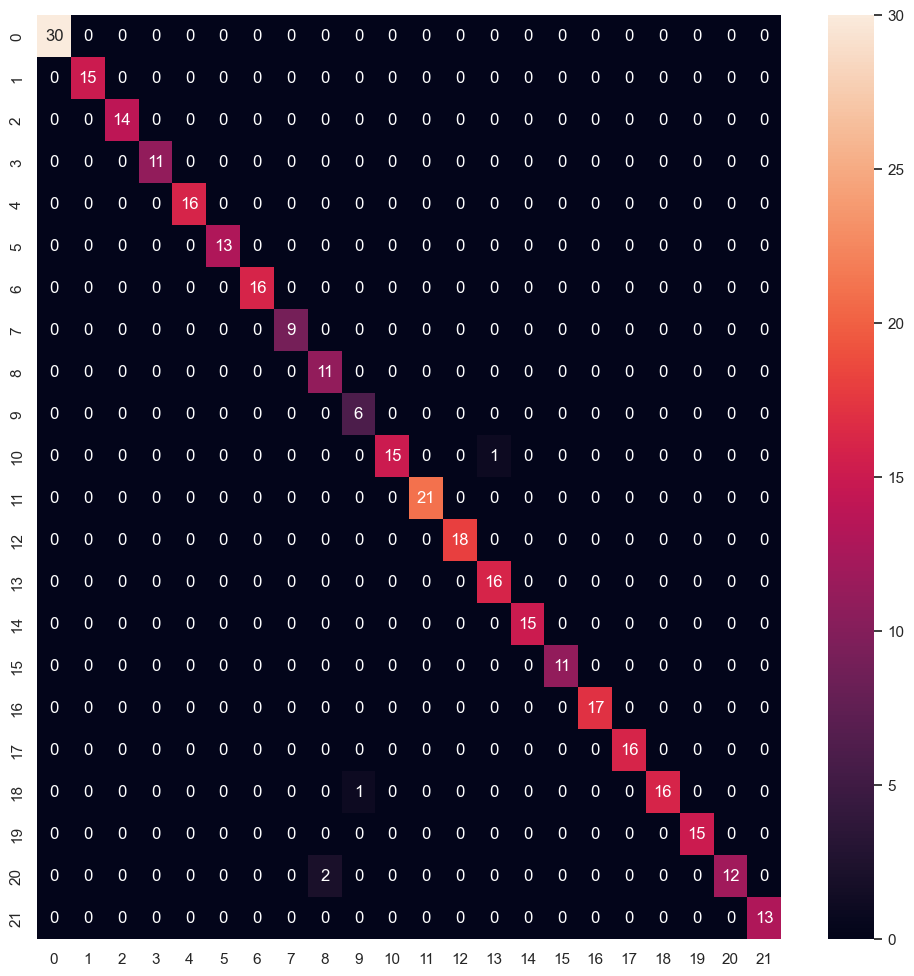



Accuract score :  0.9878787878787879


In [29]:
model_building(x_train, y_train, x_test, y_test, lgr)

## KNeighborsClassifier

In [30]:
knc = Pipeline(steps = [
    ("preprocessor", pre_pipe),
    ("KNeighborsClassifier", KNeighborsClassifier())
])

knc

Pipeline(steps=[('preprocessor',
                 Pipeline(steps=[('StandardScalar', StandardScaler()),
                                 ('VarianceThreshold', VarianceThreshold()),
                                 ('PCA', PCA(n_components=0.95))])),
                ('KNeighborsClassifier', KNeighborsClassifier())])

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        30
      banana       1.00      1.00      1.00        15
   blackgram       0.88      1.00      0.93        14
    chickpea       1.00      1.00      1.00        11
     coconut       1.00      1.00      1.00        16
      coffee       1.00      1.00      1.00        13
      cotton       0.94      1.00      0.97        16
      grapes       1.00      1.00      1.00         9
        jute       0.85      1.00      0.92        11
 kidneybeans       0.86      1.00      0.92         6
      lentil       1.00      0.94      0.97        16
       maize       1.00      0.95      0.98        21
       mango       1.00      1.00      1.00        18
   mothbeans       1.00      0.94      0.97        16
    mungbean       1.00      1.00      1.00        15
   muskmelon       1.00      1.00      1.00        11
      orange       1.00      1.00      1.00        17
      papaya       1.00    

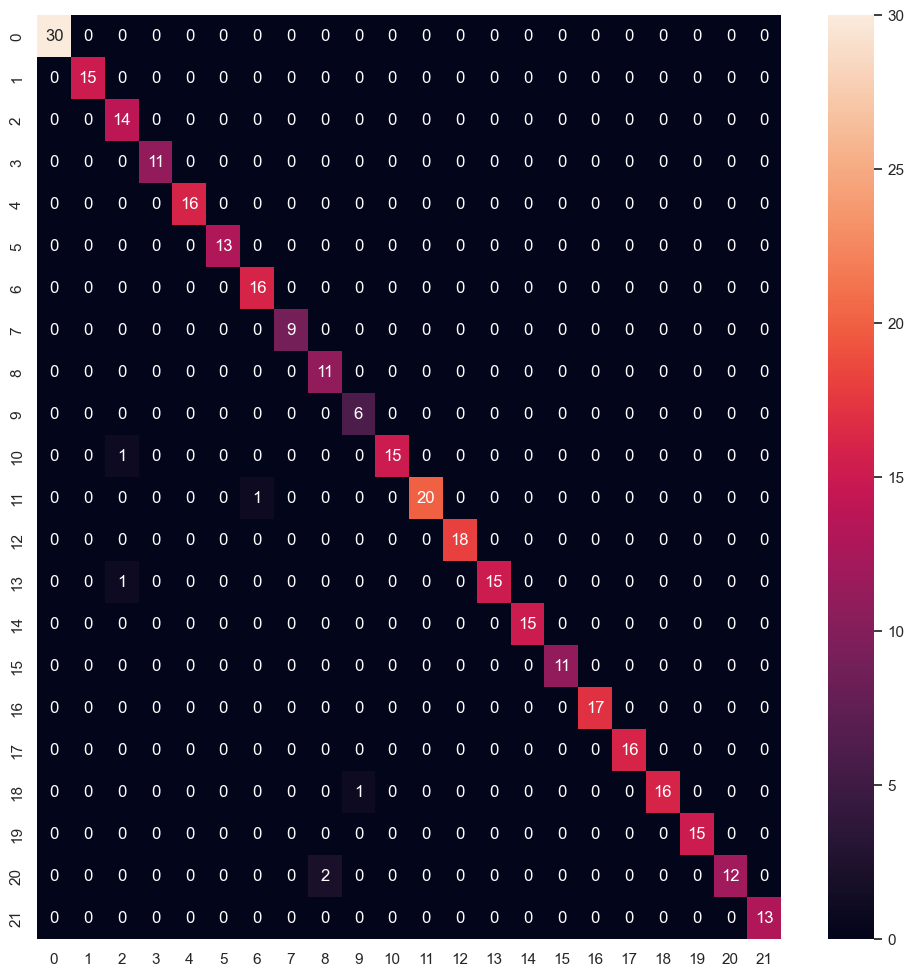



Accuract score :  0.9818181818181818


In [31]:
model_building(x_train, y_train, x_test, y_test, knc)

## DecisionTreeClassifier

In [32]:
dtc = Pipeline(steps = [
    ("preprocessor", pre_pipe),
    ("DecisionTreeClassifier", DecisionTreeClassifier())
])

dtc

Pipeline(steps=[('preprocessor',
                 Pipeline(steps=[('StandardScalar', StandardScaler()),
                                 ('VarianceThreshold', VarianceThreshold()),
                                 ('PCA', PCA(n_components=0.95))])),
                ('DecisionTreeClassifier', DecisionTreeClassifier())])

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        30
      banana       0.94      1.00      0.97        15
   blackgram       0.88      1.00      0.93        14
    chickpea       1.00      1.00      1.00        11
     coconut       0.94      1.00      0.97        16
      coffee       0.92      0.92      0.92        13
      cotton       0.94      1.00      0.97        16
      grapes       1.00      1.00      1.00         9
        jute       0.79      1.00      0.88        11
 kidneybeans       0.86      1.00      0.92         6
      lentil       0.86      0.75      0.80        16
       maize       0.95      0.86      0.90        21
       mango       1.00      1.00      1.00        18
   mothbeans       0.82      0.88      0.85        16
    mungbean       0.93      0.93      0.93        15
   muskmelon       1.00      1.00      1.00        11
      orange       1.00      1.00      1.00        17
      papaya       1.00    

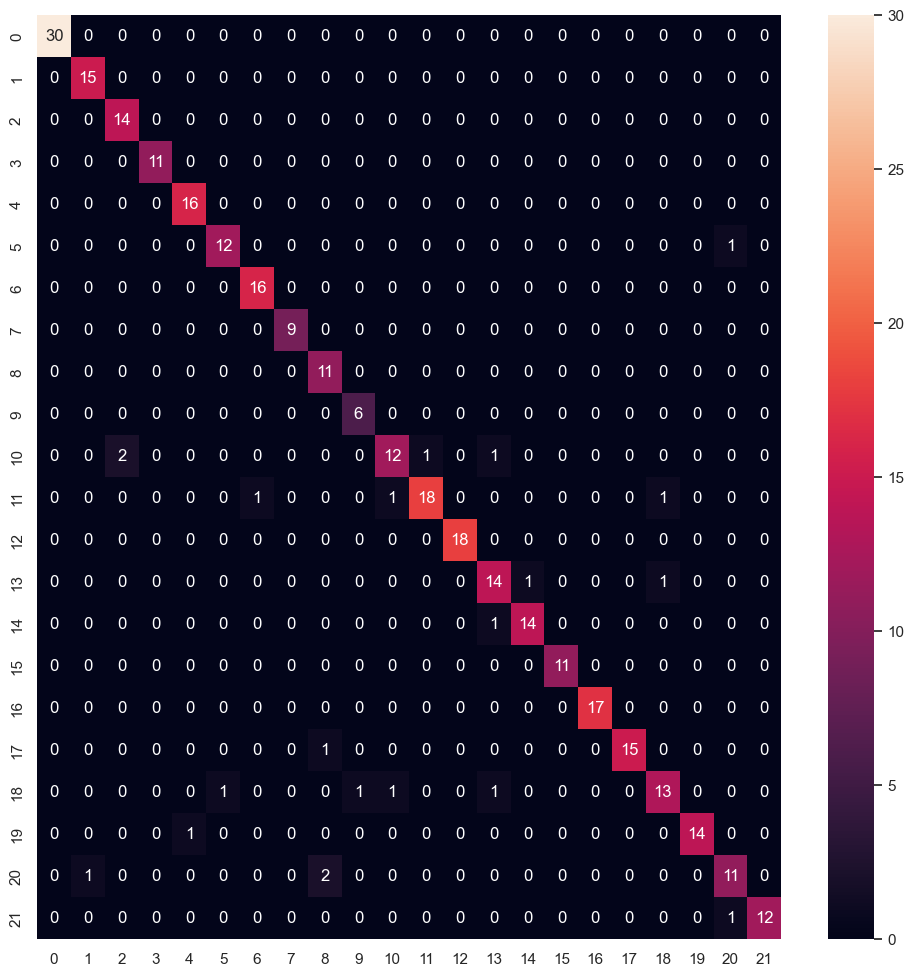



Accuract score :  0.9363636363636364


In [33]:
model_building(x_train, y_train, x_test, y_test, dtc)

## RandomForestClassifier

In [34]:
rfc = Pipeline(steps = [
    ("preprocessor", pre_pipe),
    ("RandomForestClassifier", RandomForestClassifier())
])

rfc

Pipeline(steps=[('preprocessor',
                 Pipeline(steps=[('StandardScalar', StandardScaler()),
                                 ('VarianceThreshold', VarianceThreshold()),
                                 ('PCA', PCA(n_components=0.95))])),
                ('RandomForestClassifier', RandomForestClassifier())])

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        30
      banana       1.00      1.00      1.00        15
   blackgram       0.93      1.00      0.97        14
    chickpea       1.00      1.00      1.00        11
     coconut       1.00      1.00      1.00        16
      coffee       1.00      1.00      1.00        13
      cotton       1.00      1.00      1.00        16
      grapes       1.00      1.00      1.00         9
        jute       0.85      1.00      0.92        11
 kidneybeans       0.86      1.00      0.92         6
      lentil       1.00      0.94      0.97        16
       maize       1.00      1.00      1.00        21
       mango       1.00      1.00      1.00        18
   mothbeans       1.00      1.00      1.00        16
    mungbean       1.00      1.00      1.00        15
   muskmelon       1.00      1.00      1.00        11
      orange       1.00      1.00      1.00        17
      papaya       1.00    

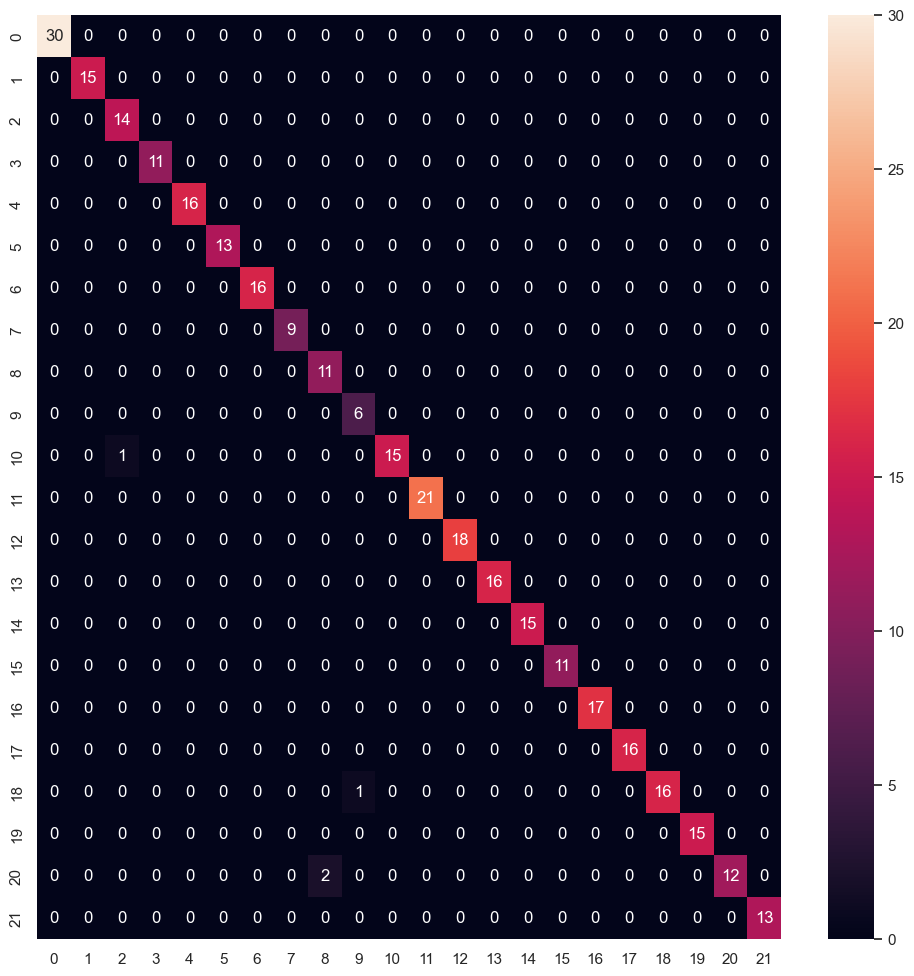



Accuract score :  0.9878787878787879


In [35]:
model_building(x_train, y_train, x_test, y_test, rfc)

## ExtraTreesClassifier

In [36]:
etc = Pipeline(steps = [
    ("preprocessor", pre_pipe),
    ("ExtraTreesClassifier", ExtraTreesClassifier())
])

etc

Pipeline(steps=[('preprocessor',
                 Pipeline(steps=[('StandardScalar', StandardScaler()),
                                 ('VarianceThreshold', VarianceThreshold()),
                                 ('PCA', PCA(n_components=0.95))])),
                ('ExtraTreesClassifier', ExtraTreesClassifier())])

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        30
      banana       1.00      1.00      1.00        15
   blackgram       0.93      1.00      0.97        14
    chickpea       1.00      1.00      1.00        11
     coconut       1.00      1.00      1.00        16
      coffee       1.00      1.00      1.00        13
      cotton       1.00      1.00      1.00        16
      grapes       1.00      1.00      1.00         9
        jute       0.85      1.00      0.92        11
 kidneybeans       0.86      1.00      0.92         6
      lentil       1.00      0.94      0.97        16
       maize       1.00      1.00      1.00        21
       mango       1.00      1.00      1.00        18
   mothbeans       0.94      1.00      0.97        16
    mungbean       1.00      1.00      1.00        15
   muskmelon       1.00      1.00      1.00        11
      orange       1.00      1.00      1.00        17
      papaya       1.00    

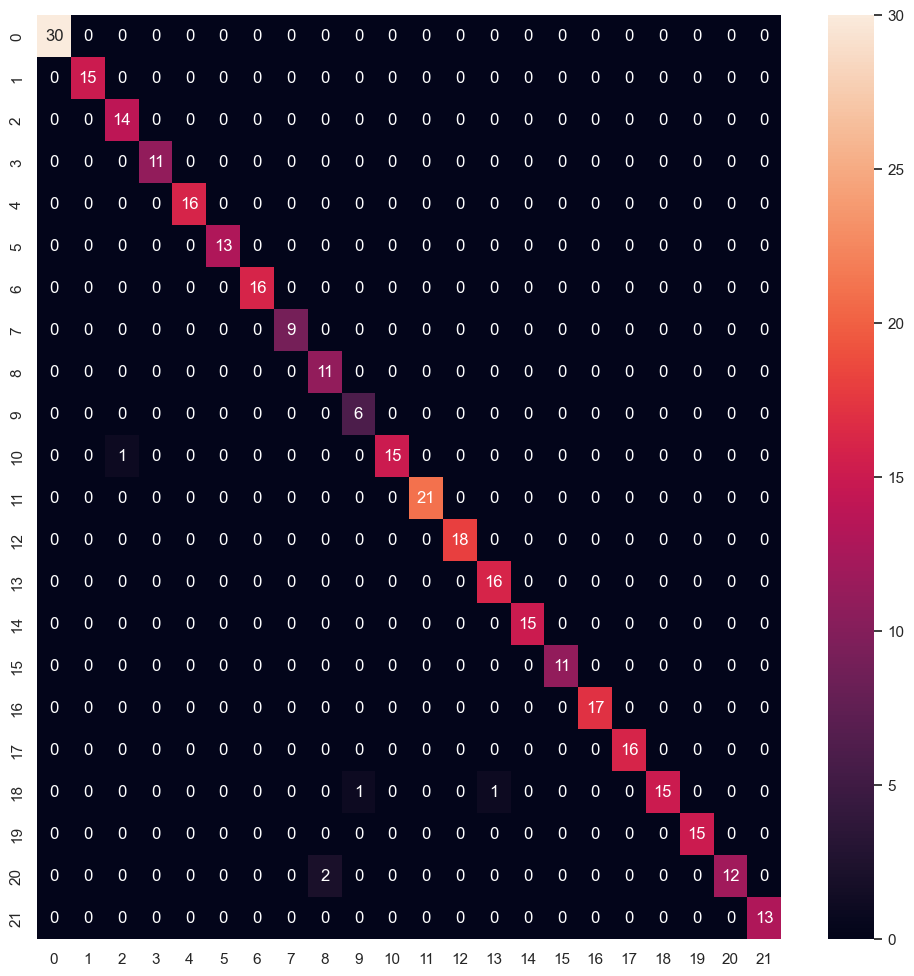



Accuract score :  0.9848484848484849


In [37]:
model_building(x_train, y_train, x_test, y_test, etc)

# SVC

In [38]:
svc = Pipeline(steps = [
    ("preprocessor", pre_pipe),
    ("SVC", SVC())
])

svc

Pipeline(steps=[('preprocessor',
                 Pipeline(steps=[('StandardScalar', StandardScaler()),
                                 ('VarianceThreshold', VarianceThreshold()),
                                 ('PCA', PCA(n_components=0.95))])),
                ('SVC', SVC())])

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        30
      banana       1.00      1.00      1.00        15
   blackgram       0.93      1.00      0.97        14
    chickpea       1.00      1.00      1.00        11
     coconut       1.00      1.00      1.00        16
      coffee       1.00      1.00      1.00        13
      cotton       1.00      1.00      1.00        16
      grapes       1.00      1.00      1.00         9
        jute       0.85      1.00      0.92        11
 kidneybeans       0.86      1.00      0.92         6
      lentil       1.00      0.94      0.97        16
       maize       1.00      1.00      1.00        21
       mango       1.00      1.00      1.00        18
   mothbeans       1.00      1.00      1.00        16
    mungbean       1.00      1.00      1.00        15
   muskmelon       1.00      1.00      1.00        11
      orange       1.00      1.00      1.00        17
      papaya       1.00    

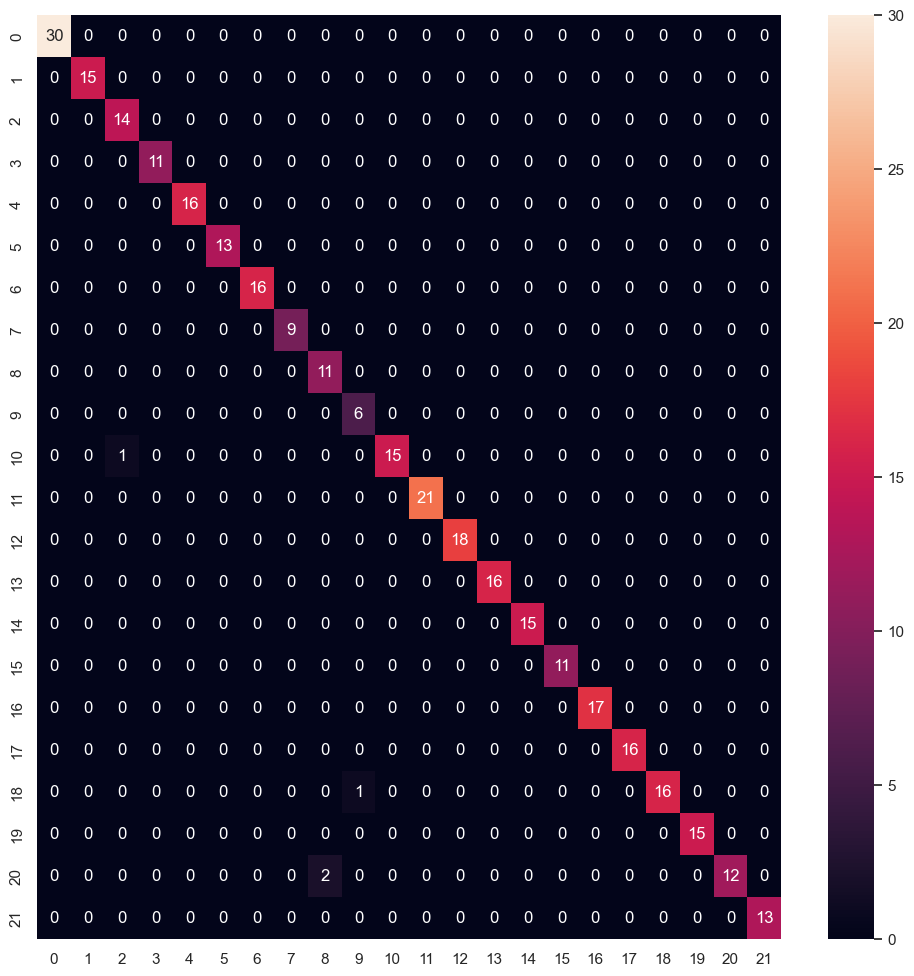



Accuract score :  0.9878787878787879


In [39]:
model_building(x_train, y_train, x_test, y_test, svc)

In [40]:
import pickle
with open('predictor.pickle', 'wb') as file:
    pickle.dump(lgr, file)